## Problem Statement

### Context

AllLife Bank is a US bank that has a growing customer base. The majority of these customers are liability customers (depositors) with varying sizes of deposits. The number of customers who are also borrowers (asset customers) is quite small, and the bank is interested in expanding this base rapidly to bring in more loan business and in the process, earn more through the interest on loans. In particular, the management wants to explore ways of converting its liability customers to personal loan customers (while retaining them as depositors).

A campaign that the bank ran last year for liability customers showed a healthy conversion rate of over 9% success. This has encouraged the retail marketing department to devise campaigns with better target marketing to increase the success ratio.

You as a Data scientist at AllLife bank have to build a model that will help the marketing department to identify the potential customers who have a higher probability of purchasing the loan.

### Objective

To predict whether a liability customer will buy personal loans, to understand which customer attributes are most significant in driving purchases, and identify which segment of customers to target more.

### Data Dictionary
* `ID`: Customer ID
* `Age`: Customer’s age in completed years
* `Experience`: #years of professional experience
* `Income`: Annual income of the customer (in thousand dollars)
* `ZIP Code`: Home Address ZIP code.
* `Family`: the Family size of the customer
* `CCAvg`: Average spending on credit cards per month (in thousand dollars)
* `Education`: Education Level. 1: Undergrad; 2: Graduate;3: Advanced/Professional
* `Mortgage`: Value of house mortgage if any. (in thousand dollars)
* `Personal_Loan`: Did this customer accept the personal loan offered in the last campaign? (0: No, 1: Yes)
* `Securities_Account`: Does the customer have securities account with the bank? (0: No, 1: Yes)
* `CD_Account`: Does the customer have a certificate of deposit (CD) account with the bank? (0: No, 1: Yes)
* `Online`: Do customers use internet banking facilities? (0: No, 1: Yes)
* `CreditCard`: Does the customer use a credit card issued by any other Bank (excluding All life Bank)? (0: No, 1: Yes)

## Importing necessary libraries

**Note**:

1. After running the above cell, kindly restart the notebook kernel (for Jupyter Notebook) or runtime (for Google Colab), write the relevant code for the project from the next cell, and run all cells sequentially from the next cell.

2. On executing the above line of code, you might see a warning regarding package dependencies. This error message can be ignored as the above code ensures that all necessary libraries and their dependencies are maintained to successfully execute the code in this notebook.

In [ ]:
# Data manipulation and analysis
import numpy as np
import pandas as pd

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns

# MLS
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer

# Models
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.svm import SVC

# Metrics
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score,
    roc_auc_score, confusion_matrix, classification_report,
    roc_curve, precision_recall_curve
)

## Loading the dataset

In [48]:
## Loading the dataset

# Load the CSV file
df = pd.read_csv('Loan_Modelling.csv')

## Data Overview

* Observations
* Sanity checks

In [49]:
# Display the first few rows
print("First 5 rows of the dataset:")
print(df.head())

First 5 rows of the dataset:
   ID  Age  Experience  Income  ZIPCode  Family  CCAvg  Education  Mortgage  \
0   1   25           1      49    91107       4    1.6          1         0   
1   2   45          19      34    90089       3    1.5          1         0   
2   3   39          15      11    94720       1    1.0          1         0   
3   4   35           9     100    94112       1    2.7          2         0   
4   5   35           8      45    91330       4    1.0          2         0   

   Personal_Loan  Securities_Account  CD_Account  Online  CreditCard  
0              0                   1           0       0           0  
1              0                   1           0       0           0  
2              0                   0           0       0           0  
3              0                   0           0       0           0  
4              0                   0           0       0           1  


In [50]:
# Check dataset shape rows columns...
print("Dataset dimensions (rows, columns)")
print(df.shape)

Dataset dimensions (rows, columns)
(5000, 14)


In [51]:
# Check data types
print("Data types of each column")
print(df.dtypes)

Data types of each column
ID                      int64
Age                     int64
Experience              int64
Income                  int64
ZIPCode                 int64
Family                  int64
CCAvg                 float64
Education               int64
Mortgage                int64
Personal_Loan           int64
Securities_Account      int64
CD_Account              int64
Online                  int64
CreditCard              int64
dtype: object


In [52]:
# Check for missing values
print("Missing values in each column")
print(df.isnull().sum())


Missing values in each column
ID                    0
Age                   0
Experience            0
Income                0
ZIPCode               0
Family                0
CCAvg                 0
Education             0
Mortgage              0
Personal_Loan         0
Securities_Account    0
CD_Account            0
Online                0
CreditCard            0
dtype: int64


In [53]:
# Summary stats
print("Summary statistics for numerical columns")
print(df.describe())

Summary statistics for numerical columns
                ID          Age   Experience       Income       ZIPCode  \
count  5000.000000  5000.000000  5000.000000  5000.000000   5000.000000   
mean   2500.500000    45.338400    20.104600    73.774200  93169.257000   
std    1443.520003    11.463166    11.467954    46.033729   1759.455086   
min       1.000000    23.000000    -3.000000     8.000000  90005.000000   
25%    1250.750000    35.000000    10.000000    39.000000  91911.000000   
50%    2500.500000    45.000000    20.000000    64.000000  93437.000000   
75%    3750.250000    55.000000    30.000000    98.000000  94608.000000   
max    5000.000000    67.000000    43.000000   224.000000  96651.000000   

            Family        CCAvg    Education     Mortgage  Personal_Loan  \
count  5000.000000  5000.000000  5000.000000  5000.000000    5000.000000   
mean      2.396400     1.937938     1.881000    56.498800       0.096000   
std       1.147663     1.747659     0.839869   101.7138

In [ ]:
# Check unique values 
print("Unique values for categorical ")
for col in ['Education', 'Personal_Loan', 'Securities_Account', 'CD_Account', 'Online', 'CreditCard']:
    print(f"{col}: {df[col].unique()}")

Unique values for categorical variables:
Education: [1 2 3]
Personal_Loan: [0 1]
Securities_Account: [1 0]
CD_Account: [0 1]
Online: [0 1]
CreditCard: [0 1]


In [55]:
# Check the distribution of the target variable
print("Distribution of target variable (Personal_Loan)")
print(df['Personal_Loan'].value_counts())
print(f"Percentage of customers who accepted loan: {df['Personal_Loan'].mean()*100:.2f}%")

Distribution of target variable (Personal_Loan)
0    4520
1     480
Name: Personal_Loan, dtype: int64
Percentage of customers who accepted loan: 9.60%


In [56]:
# Check for outliers in Income and CCAvg
print("Checking for outliers in Income")
print(df[df['Income'] > df['Income'].quantile(0.99)].shape[0], "potential outliers in Income")

Checking for outliers in Income
48 potential outliers in Income


In [57]:
# Check for any inconsistencies in data
print("Checking for negative experience value")
print(df[df['Experience'] < 0].shape[0], "records with negative experience")


Checking for negative experience value
52 records with negative experience


In [58]:
# Check relationship between Age and Experience
print("Checking relationship between Age and Experience")
print("Correlation", df['Age'].corr(df['Experience']))
print("Minimum Age", df['Age'].min())
print("Minimum Experience", df['Experience'].min())
print("Maximum Age", df['Age'].max())
print("Maximum Experience", df['Experience'].max())


Checking relationship between Age and Experience
Correlation 0.9942148569683318
Minimum Age 23
Minimum Experience -3
Maximum Age 67
Maximum Experience 43


## Exploratory Data Analysis.

- EDA is an important part of any project involving data.
- It is important to investigate and understand the data better before building a model with it.
- A few questions have been mentioned below which will help you approach the analysis in the right manner and generate insights from the data.
- A thorough analysis of the data, in addition to the questions mentioned below, should be done.

**Questions**:

1. What is the distribution of mortgage attribute? Are there any noticeable patterns or outliers in the distribution?
2. How many customers have credit cards?
3. What are the attributes that have a strong correlation with the target attribute (personal loan)?
4. How does a customer's interest in purchasing a loan vary with their age?
5. How does a customer's interest in purchasing a loan vary with their education?

In [59]:

# 1. What is the distribution of mortgage attribute? Are there any noticeable patterns or outliers?
plt.figure(figsize=(12, 6))

##most of the customers have a median value of 0  while mean is higher than outliers 

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

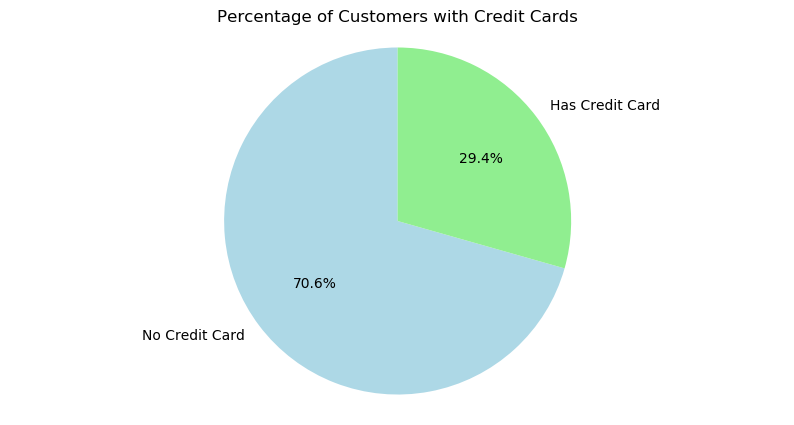

Number of customers with credit cards 1470
Percentage of customers with credit cards 29.40%


In [60]:
# 2. How many customers have credit cards?
plt.figure(figsize=(10, 5))

# Get the value counts for CreditCard column
credit_card_counts = df['CreditCard'].value_counts()

# Create labels based on the index values
labels = ['No Credit Card', 'Has Credit Card']
if 0 in credit_card_counts.index and 1 in credit_card_counts.index:
    values = [credit_card_counts[0], credit_card_counts[1]]
else:
    # Handle case where one of the values might be missing
    values = []
    for i, label in enumerate(['No Credit Card', 'Has Credit Card']):
        values.append(credit_card_counts.get(i, 0))

# make the pie chart
plt.pie(values, labels=labels, autopct='%1.1f%%', startangle=90, 
        colors=['lightblue', 'lightgreen'])
plt.title('Percentage of Customers with Credit Cards')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle
plt.show()

# show results
print(f"Number of customers with credit cards {credit_card_counts.get(1, 0)}")
print(f"Percentage of customers with credit cards {credit_card_counts.get(1, 0) / len(df) * 100:.2f}%")

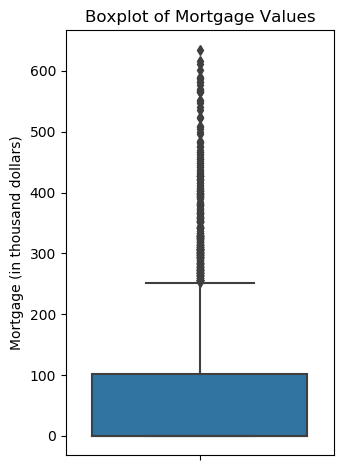

Mortgage statistics
count    5000.000000
mean       56.498800
std       101.713802
min         0.000000
25%         0.000000
50%         0.000000
75%       101.000000
max       635.000000
Name: Mortgage, dtype: float64
Percentage of customers with mortgage 30.76%


In [61]:
# Boxplot to identify outliers
plt.subplot(1, 2, 2)
sns.boxplot(y=df['Mortgage'])
plt.title('Boxplot of Mortgage Values')
plt.ylabel('Mortgage (in thousand dollars)')

plt.tight_layout()
plt.show()

print("Mortgage statistics")
print(df['Mortgage'].describe())
print(f"Percentage of customers with mortgage {(df['Mortgage'] > 0).mean()*100:.2f}%")


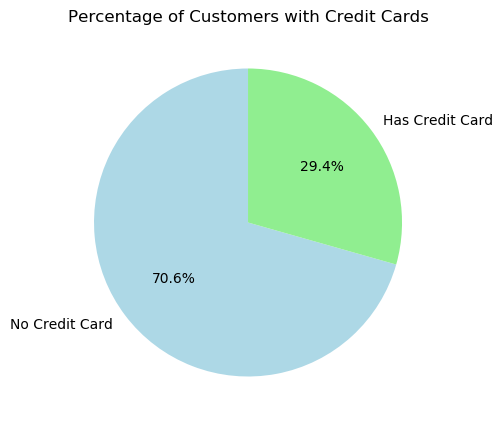

Number of customers with credit cards 1470
Percentage of customers with credit cards 29.40%


In [62]:
# 2. How many customers have credit cards?
plt.figure(figsize=(10, 5))
credit_card_counts = df['CreditCard'].value_counts()
plt.pie(credit_card_counts, labels=['No Credit Card', 'Has Credit Card'], 
        autopct='%1.1f%%', startangle=90, colors=['lightblue', 'lightgreen'])
plt.title('Percentage of Customers with Credit Cards')
plt.show()

print(f"Number of customers with credit cards {credit_card_counts.get(1, 0)}")
print(f"Percentage of customers with credit cards {credit_card_counts.get(1, 0) / len(df) * 100:.2f}%")


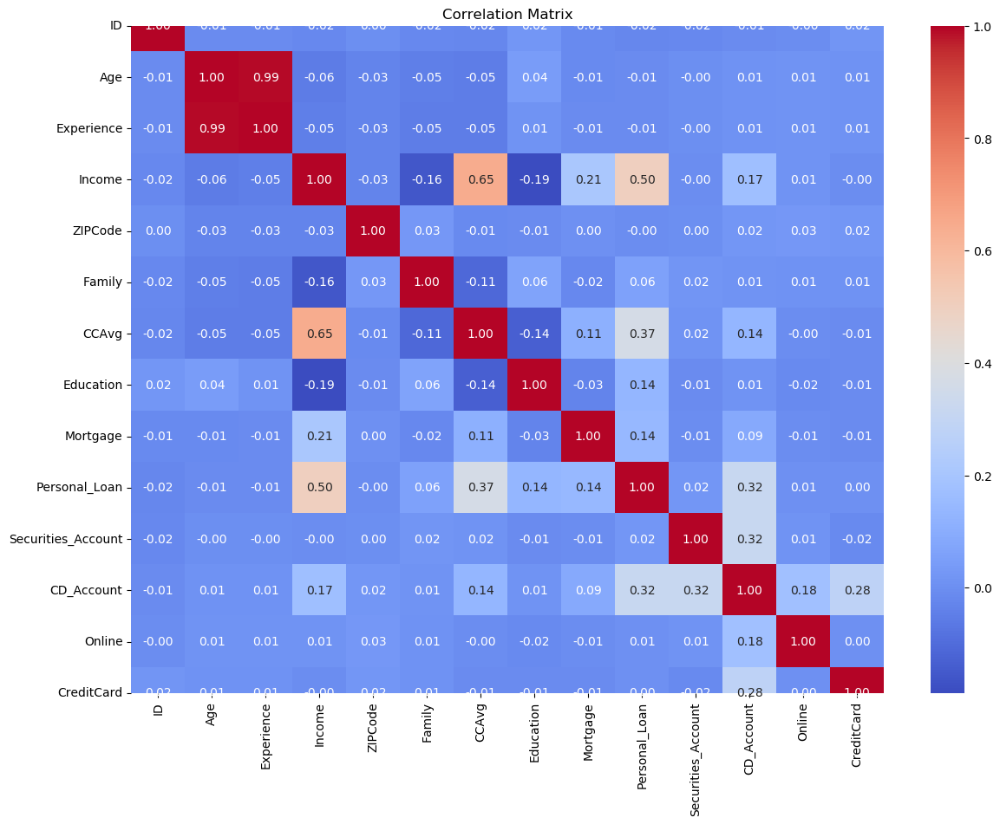

Features with highest correlation with Personal_Loan:
Personal_Loan         1.000000
Income                0.502462
CCAvg                 0.366889
CD_Account            0.316355
Mortgage              0.142095
Education             0.136722
Family                0.061367
Securities_Account    0.021954
Online                0.006278
CreditCard            0.002802
ZIPCode              -0.002974
Experience           -0.007413
Age                  -0.007726
ID                   -0.024801
Name: Personal_Loan, dtype: float64


In [63]:
# 3. What are the attributes that have a strong correlation with the target attribute (personal loan)?
plt.figure(figsize=(14, 10))
correlation_matrix = df.corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix')
plt.show()

print("Features with highest correlation with Personal_Loan:")
correlations = correlation_matrix['Personal_Loan'].sort_values(ascending=False)
print(correlations)

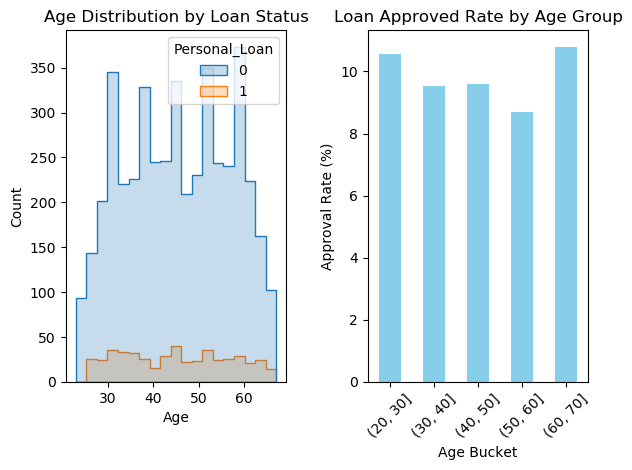

In [64]:
# 4. How does a customer's interest in purchasing a loan vary with their age?
# Age distribution by loan status
plt.subplot(1, 2, 1)
sns.histplot(data=df, x='Age', hue='Personal_Loan', element='step', common_norm=False)
plt.title('Age Distribution by Loan Status')
plt.xlabel('Age')
plt.ylabel('Count')

# Loan acceptance rate by age group
plt.subplot(1, 2, 2)
df['Age_Group'] = pd.cut(df['Age'], bins=[20, 30, 40, 50, 60, 70])
age_loan = df.groupby('Age_Group')['Personal_Loan'].mean() * 100
age_loan.plot(kind='bar', color='skyblue')
plt.title('Loan Approved Rate by Age Group')
plt.xlabel('Age Bucket')
plt.ylabel('Approval Rate (%)')
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()



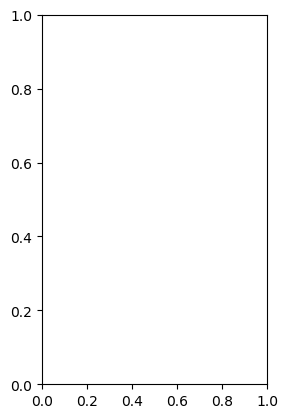

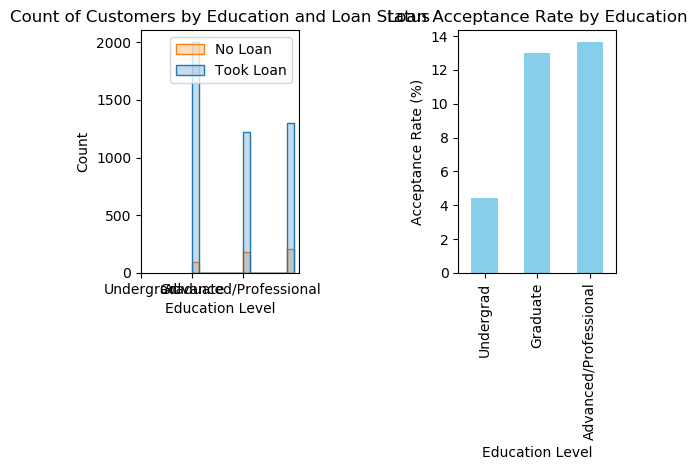

In [65]:
plt.subplot(1, 2, 2)
education_loan = pd.crosstab(df['Education'], df['Personal_Loan'])
education_loan.plot(kind='bar', stacked=True)

plt.subplot(1, 2, 1)
sns.histplot(data=df, x='Education', hue='Personal_Loan', element='step', common_norm=False)
plt.title('Count of Customers by Education and Loan Status')
plt.xlabel('Education Level')
plt.ylabel('Count')
plt.xticks([0, 1, 2], ['Undergrad', 'Graduate', 'Advanced/Professional'])
plt.legend(['No Loan', 'Took Loan'])

plt.subplot(1, 2, 2)
df['Education Level'] = pd.cut(df['Education'], bins=[0, 50, 100, 150, 200, 250])
education_rate = df.groupby('Education')['Personal_Loan'].mean() * 100
education_rate.plot(kind='bar', color='skyblue')
plt.title('Loan Acceptance Rate by Education')
plt.xlabel('Education Level')
plt.ylabel('Acceptance Rate (%)')
plt.xticks([0, 1, 2], ['Undergrad', 'Graduate', 'Advanced/Professional'])

plt.tight_layout()
plt.show()

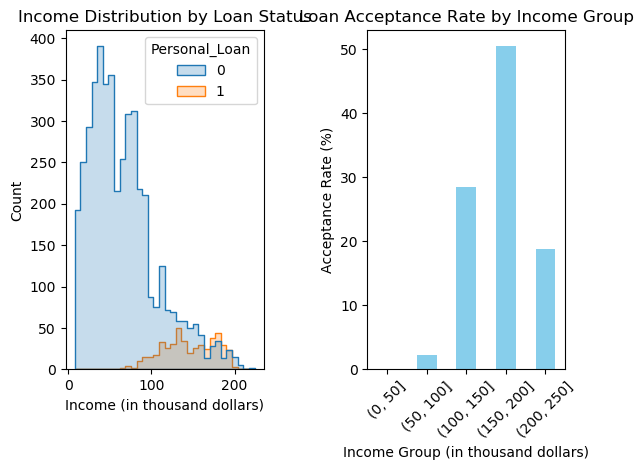

In [66]:
#additional eda

# Income distribution by loan status
plt.subplot(1, 2, 1)
sns.histplot(data=df, x='Income', hue='Personal_Loan', element='step', common_norm=False)
plt.title('Income Distribution by Loan Status')
plt.xlabel('Income (in thousand dollars)')
plt.ylabel('Count')

# Loan acceptance rate by income group
plt.subplot(1, 2, 2)
df['Income_Group'] = pd.cut(df['Income'], bins=[0, 50, 100, 150, 200, 250])
income_loan = df.groupby('Income_Group')['Personal_Loan'].mean() * 100
income_loan.plot(kind='bar', color='skyblue')
plt.title('Loan Acceptance Rate by Income Group')
plt.xlabel('Income Group (in thousand dollars)')
plt.ylabel('Acceptance Rate (%)')
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

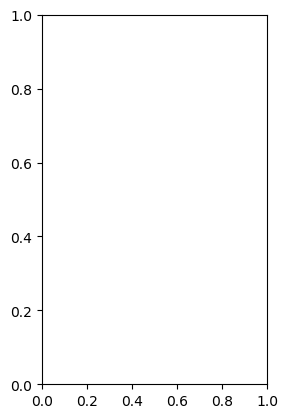

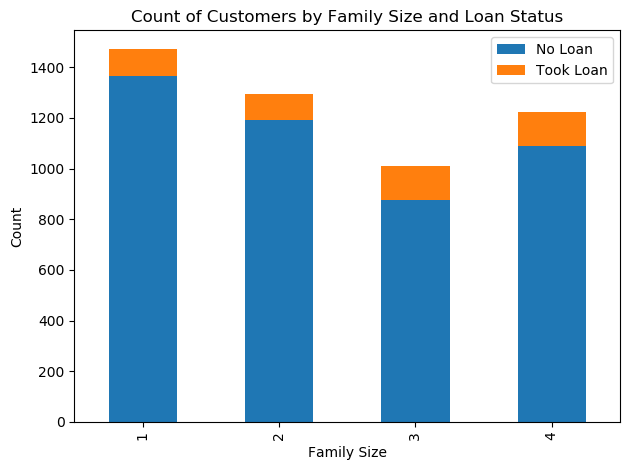

In [67]:

# Additional EDA: Family Size vs Loan Status

family_loan = pd.crosstab(df['Family'], df['Personal_Loan'])

plt.subplot(1,2,1 )
family_loan.plot(kind='bar', stacked=True)
plt.title('Count of Customers by Family Size and Loan Status')
plt.xlabel('Family Size')
plt.ylabel('Count')
plt.legend(['No Loan', 'Took Loan'])

plt.tight_layout()
plt.show()


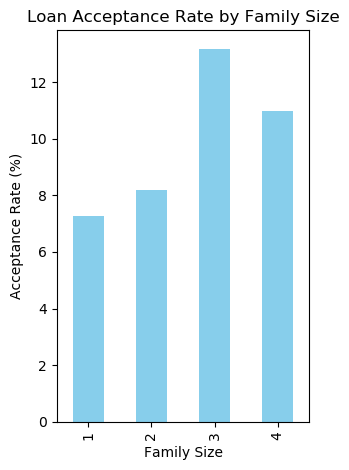

In [68]:
family_rate = df.groupby('Family')['Personal_Loan'].mean() * 100

plt.subplot(1, 2, 2)
family_rate.plot(kind='bar', color='skyblue')
plt.title('Loan Acceptance Rate by Family Size')
plt.xlabel('Family Size')
plt.ylabel('Acceptance Rate (%)')

plt.tight_layout()
plt.show()

## Data Preprocessing

* Missing value treatment
* Feature engineering (if needed)
* Outlier detection and treatment (if needed)
* Preparing data for modeling
* Any other preprocessing steps (if needed)

In [69]:
# Check for missing values again to confirm
print("Missing values in each column:")
print(df.isnull().sum())

Missing values in each column:
ID                    0
Age                   0
Experience            0
Income                0
ZIPCode               0
Family                0
CCAvg                 0
Education             0
Mortgage              0
Personal_Loan         0
Securities_Account    0
CD_Account            0
Online                0
CreditCard            0
Age_Group             0
Education Level       0
Income_Group          0
dtype: int64


In [70]:

# Handle negative experience values
if df[df['Experience'] < 0].shape[0] > 0:
    print(f"Fixing {df[df['Experience'] < 0].shape[0]} records with negative experience values")
    # Replace negative experience with Age - 21 (assuming working age starts at 21)
    df.loc[df['Experience'] < 0, 'Experience'] = df.loc[df['Experience'] < 0, 'Age'] - 21

Fixing 52 records with negative experience values


In [71]:

# Create new features
print("Creating new features...")

# Create income to CCAvg ratio (spending ratio) with conditional handling
df['Income_CCAvg_Ratio'] = np.where(
    df['CCAvg'] == 0,  # Condition: if CCAvg is zero
    0,                 # Then: set to 0
    df['Income'] / df['CCAvg']  # Else: calculate the actual ratio
)

# Create debt-to-income ratio with conditional handling
df['Debt_to_Income'] = np.where(
    df['Income'] == 0,  # Condition: if Income is zero
    0,                  # Then: set to 0
    df['Mortgage'] / df['Income']  # Else: calculate the actual ratio
)

# Create family income per person with conditional handling
df['Income_per_Family'] = np.where(
    df['Family'] == 0,  # Unlikely but just to be safe
    df['Income'],       # If family size is 0, use income
    df['Income'] / df['Family']  # Else: calculate the actual per-family income
)

# Create age buckets
age_bins = [18, 25, 35, 45, 55, 65, 100]
age_labels = ['18-25', '26-35', '36-45', '46-55', '56-65', '65+']
df['Age_Bucket'] = pd.cut(df['Age'], bins=age_bins, labels=age_labels, right=False)

# Calculate average metrics by age bucket
age_bucket_stats = df.groupby('Age_Bucket').agg({
    'Income': 'mean',
    'Mortgage': 'mean',
    'CCAvg': 'mean',
    'Personal_Loan': 'mean'
}).reset_index()

# Rename columns for clarity
age_bucket_stats.columns = ['Age_Bucket', 'Avg_Income', 'Avg_Mortgage', 'Avg_CC_Spending', 'Loan_Acceptance_Rate']

# Convert loan acceptance rate to percentage
age_bucket_stats['Loan_Acceptance_Rate'] = age_bucket_stats['Loan_Acceptance_Rate'] * 100

# Display the age bucket statistics
print("Age bucket statistics")
print(age_bucket_stats)

# Create a feature for income relative to age group average
for age_group in age_labels:
    avg_income = age_bucket_stats.loc[age_bucket_stats['Age_Bucket'] == age_group, 'Avg_Income'].values[0]
    mask = df['Age_Bucket'] == age_group
    df.loc[mask, 'Income_vs_Age_Group_Avg'] = df.loc[mask, 'Income'] / avg_income
    

Creating new features...
Age bucket statistics
  Age_Bucket  Avg_Income  Avg_Mortgage  Avg_CC_Spending  Loan_Acceptance_Rate
0      18-25   72.125000     35.375000         2.173250              0.000000
1      26-35   76.579871     59.339797         2.019012             10.895660
2      36-45   75.987392     56.449961         2.020110              9.219858
3      46-55   73.587214     57.943962         1.911555              9.629045
4      56-65   68.959184     54.410612         1.820547              8.897959
5        65+   76.827586     44.060345         1.728793             12.068966


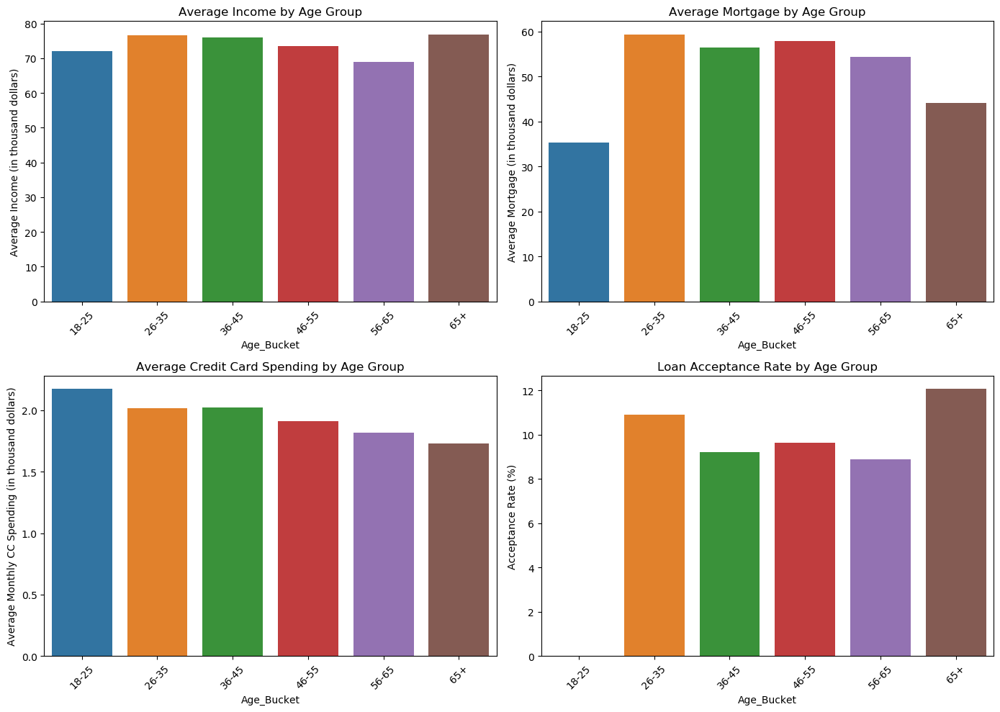

In [72]:

# Visualize metrics by age bucket
plt.figure(figsize=(14, 10))

# Income by age
plt.subplot(2, 2, 1)
sns.barplot(x='Age_Bucket', y='Avg_Income', data=age_bucket_stats)
plt.title('Average Income by Age Group')
plt.ylabel('Average Income (in thousand dollars)')
plt.xticks(rotation=45)

# Mortgage by age
plt.subplot(2, 2, 2)
sns.barplot(x='Age_Bucket', y='Avg_Mortgage', data=age_bucket_stats)
plt.title('Average Mortgage by Age Group')
plt.ylabel('Average Mortgage (in thousand dollars)')
plt.xticks(rotation=45)

# CC spending by age
plt.subplot(2, 2, 3)
sns.barplot(x='Age_Bucket', y='Avg_CC_Spending', data=age_bucket_stats)
plt.title('Average Credit Card Spending by Age Group')
plt.ylabel('Average Monthly CC Spending (in thousand dollars)')
plt.xticks(rotation=45)

# Loan acceptance by age
plt.subplot(2, 2, 4)
sns.barplot(x='Age_Bucket', y='Loan_Acceptance_Rate', data=age_bucket_stats)
plt.title('Loan Acceptance Rate by Age Group')
plt.ylabel('Acceptance Rate (%)')
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

In [73]:

# ZIP Code transformation - since it's a categorical variable with too many levels
# We'll extract the first digit as a region indicator
df['ZIP_Region'] = df['ZIPCode'].astype(str).str[0].astype(int)

In [74]:
# Handle outliers using capping
# Cap Income at 99th percentile
income_cap = df['Income'].quantile(0.99)
df['Income'] = np.where(df['Income'] > income_cap, income_cap, df['Income'])

# Cap CCAvg at 99th percentile
ccavg_cap = df['CCAvg'].quantile(0.99)
df['CCAvg'] = np.where(df['CCAvg'] > ccavg_cap, ccavg_cap, df['CCAvg'])

# Cap Mortgage at 99th percentile
mortgage_cap = df['Mortgage'].quantile(0.99)
df['Mortgage'] = np.where(df['Mortgage'] > mortgage_cap, mortgage_cap, df['Mortgage'])

In [75]:
# Preparing data for modeling
# Separate features and target variable
X = df.drop(['ID', 'Personal_Loan', 'ZIPCode', 'Age_Bucket'], axis=1)  # Drop ID, target variable, original ZIP code, and Age_Bucket (categorical)
y = df['Personal_Loan']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

print("Training set shape:", X_train.shape)
print("Testing set shape:", X_test.shape)
print("Class distribution in training set:")
print(y_train.value_counts(normalize=True))
print("Class distribution in testing set:")
print(y_test.value_counts(normalize=True))

# Standardize numerical features
numerical_features = ['Age', 'Experience', 'Income', 'CCAvg', 'Mortgage', 
                     'Income_CCAvg_Ratio', 'Debt_to_Income', 'Income_per_Family', 'Income_vs_Age_Group_Avg']
categorical_features = ['Education', 'Securities_Account', 'CD_Account', 'Online', 'CreditCard', 'ZIP_Region', 'Family']

Training set shape: (4000, 19)
Testing set shape: (1000, 19)
Class distribution in training set:
0    0.904
1    0.096
Name: Personal_Loan, dtype: float64
Class distribution in testing set:
0    0.904
1    0.096
Name: Personal_Loan, dtype: float64


In [76]:
# Create preprocessor
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numerical_features),
        ('cat', OneHotEncoder(categories='auto'), categorical_features)
    ])

# Fit the preprocessor to the training data
X_train_transformed = preprocessor.fit_transform(X_train)
X_test_transformed = preprocessor.transform(X_test)

print("Transformed training set shape:", X_train_transformed.shape)
print("Transformed testing set shape:", X_test_transformed.shape)

Transformed training set shape: (4000, 25)
Transformed testing set shape: (1000, 25)


## Model Building

### Model Evaluation Criterion

### For this classification problem, we'll use the following metrics:
#### 1. Accuracy: Overall correctness of the model
#### 2. Precision: Ability to identify positive cases correctly (minimize false positives)
#### 3. Recall: Ability to find all positive cases (minimize false negatives)
#### 4. F1-score: Harmonic mean of precision and recall
#### 5. ROC-AUC: Area under the ROC curve, measuring how well the model distinguishes between classes

#### Since the bank's goal is to identify customers who are likely to take a loan,
#### we'll prioritize precision (to minimize wasted marketing resources) and recall
#### (to not miss potential customers).

In [77]:

# Function to evaluate and print results
def evaluate_model(model, X_train, X_test, y_train, y_test, model_name):
    # Train the model
    model.fit(X_train, y_train)
    
    # Make predictions
    y_pred = model.predict(X_test)
    y_pred_proba = model.predict_proba(X_test)[:, 1]
    
    # Compute cross-validation scores
    cv_scores = cross_val_score(model, X_train, y_train, cv=5, scoring='roc_auc')
    
    # Calculate metrics
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    roc_auc = roc_auc_score(y_test, y_pred_proba)
    
    # Print results
    print(f"\nModel: {model_name}")
    print(f"Cross-validation ROC-AUC: {cv_scores.mean():.4f} (±{cv_scores.std():.4f})")
    print(f"Test Accuracy: {accuracy:.4f}")
    print(f"Test Precision: {precision:.4f}")
    print(f"Test Recall: {recall:.4f}")
    print(f"Test F1-score: {f1:.4f}")
    print(f"Test ROC-AUC: {roc_auc:.4f}")
    
    # Print classification report
    print("\nClassification Report:")
    print(classification_report(y_test, y_pred))
    
    # Plot confusion matrix
    plt.figure(figsize=(6, 6))
    cm = confusion_matrix(y_test, y_pred)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
    plt.title(f'Confusion Matrix - {model_name}')
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.show()
    
    # Plot ROC curve
    plt.figure(figsize=(6, 6))
    fpr, tpr, _ = roc_curve(y_test, y_pred_proba)
    plt.plot(fpr, tpr, label=f'ROC curve (area = {roc_auc:.4f})')
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(f'ROC Curve - {model_name}')
    plt.legend(loc='lower right')
    plt.show()
    
    return {
        'model': model,
        'accuracy': accuracy,
        'precision': precision,
        'recall': recall,
        'f1_score': f1,
        'roc_auc': roc_auc,
        'cv_roc_auc': cv_scores.mean()
    }


### Model Building


Training Logistic Regression...

Model: Logistic Regression
Cross-validation ROC-AUC: 0.9667 (±0.0117)
Test Accuracy: 0.9220
Test Precision: 0.5556
Test Recall: 0.9375
Test F1-score: 0.6977
Test ROC-AUC: 0.9729

Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.92      0.96       904
           1       0.56      0.94      0.70        96

    accuracy                           0.92      1000
   macro avg       0.77      0.93      0.83      1000
weighted avg       0.95      0.92      0.93      1000



/Users/memorodriguez/opt/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/Users/memorodriguez/opt/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/Users/memorodriguez/opt/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/Users/memorodriguez/opt/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/Users/memorodriguez/opt/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:

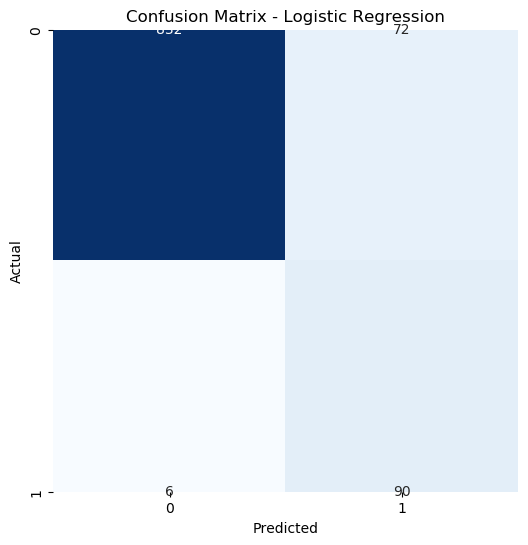

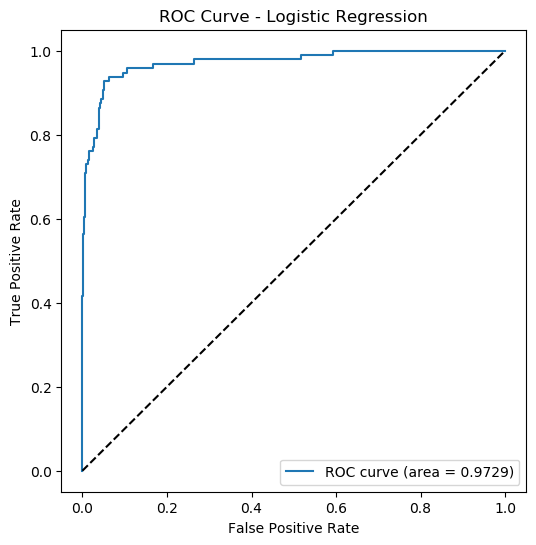


Training Decision Tree...

Model: Decision Tree
Cross-validation ROC-AUC: 0.9271 (±0.0253)
Test Accuracy: 0.9850
Test Precision: 0.8932
Test Recall: 0.9583
Test F1-score: 0.9246
Test ROC-AUC: 0.9731

Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.99      0.99       904
           1       0.89      0.96      0.92        96

    accuracy                           0.98      1000
   macro avg       0.94      0.97      0.96      1000
weighted avg       0.99      0.98      0.99      1000



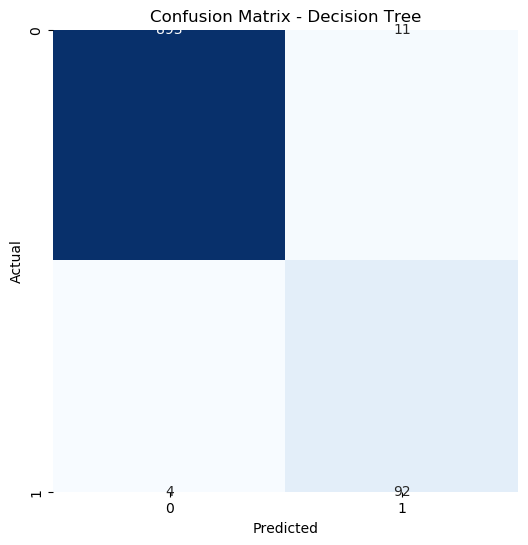

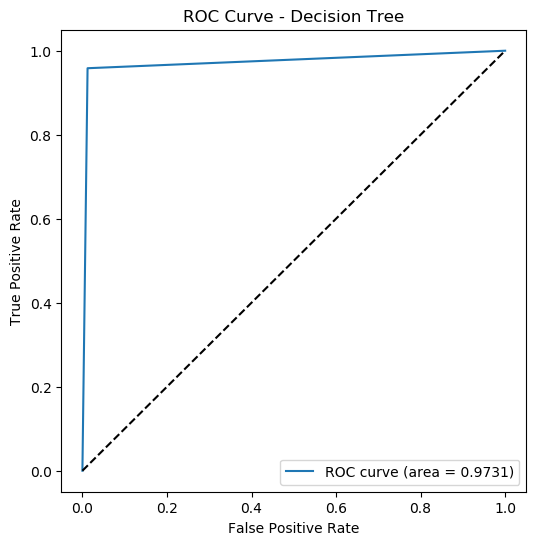


Training Random Forest...

Model: Random Forest
Cross-validation ROC-AUC: 0.9968 (±0.0013)
Test Accuracy: 0.9910
Test Precision: 0.9677
Test Recall: 0.9375
Test F1-score: 0.9524
Test ROC-AUC: 0.9989

Classification Report:
              precision    recall  f1-score   support

           0       0.99      1.00      1.00       904
           1       0.97      0.94      0.95        96

    accuracy                           0.99      1000
   macro avg       0.98      0.97      0.97      1000
weighted avg       0.99      0.99      0.99      1000



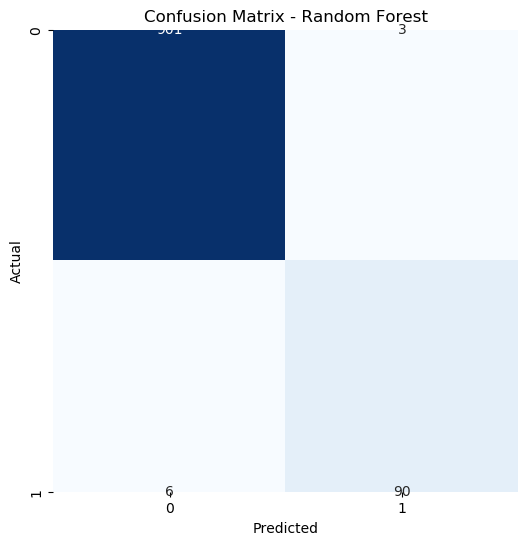

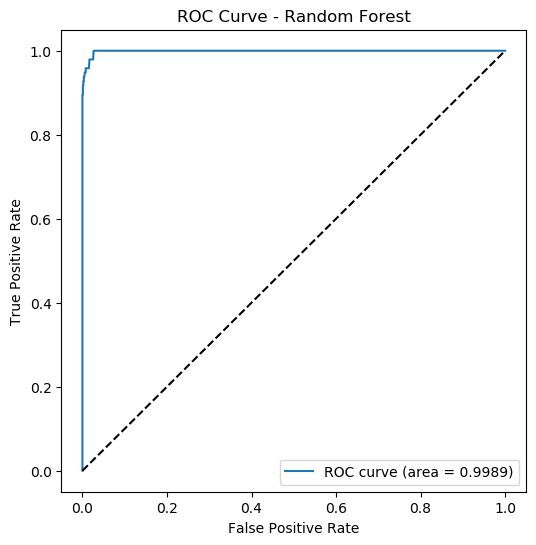


Training Gradient Boosting...

Model: Gradient Boosting
Cross-validation ROC-AUC: 0.9972 (±0.0014)
Test Accuracy: 0.9910
Test Precision: 0.9485
Test Recall: 0.9583
Test F1-score: 0.9534
Test ROC-AUC: 0.9990

Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.99      1.00       904
           1       0.95      0.96      0.95        96

    accuracy                           0.99      1000
   macro avg       0.97      0.98      0.97      1000
weighted avg       0.99      0.99      0.99      1000



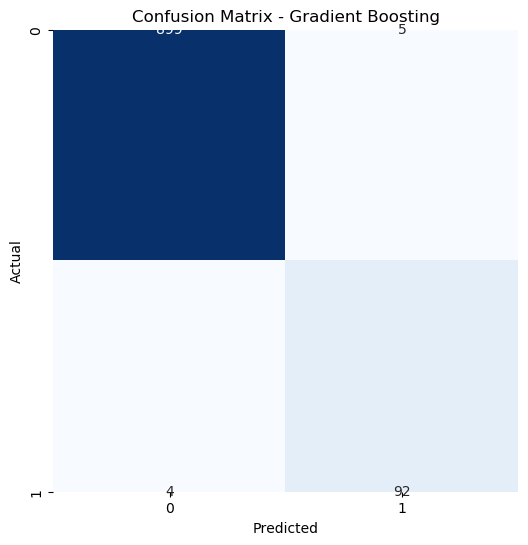

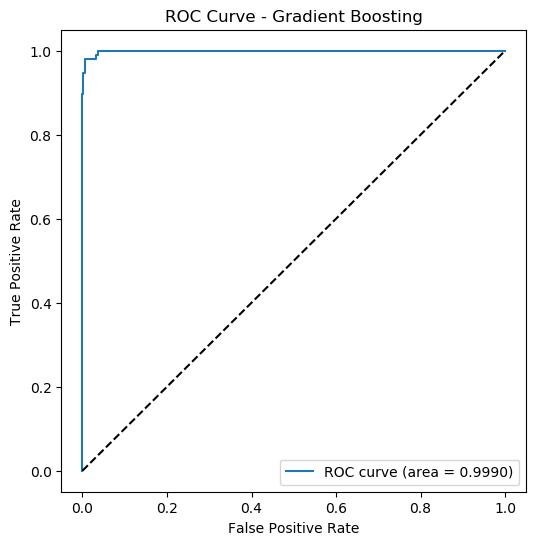


Model Performance Comparison:
                    accuracy precision    recall  f1_score   roc_auc  \
Logistic Regression    0.922  0.555556    0.9375  0.697674  0.972898   
Decision Tree          0.985  0.893204  0.958333  0.924623  0.973083   
Random Forest          0.991  0.967742    0.9375  0.952381  0.998911   
Gradient Boosting      0.991  0.948454  0.958333  0.953368  0.999009   

                    cv_roc_auc  
Logistic Regression    0.96673  
Decision Tree          0.92711  
Random Forest         0.996771  
Gradient Boosting     0.997161  


In [78]:
# Initialize models with balanced class weights to handle imbalanced data
models = {
    'Logistic Regression': LogisticRegression(class_weight='balanced', random_state=42, max_iter=1000),
    'Decision Tree': DecisionTreeClassifier(class_weight='balanced', random_state=42),
    'Random Forest': RandomForestClassifier(class_weight='balanced', random_state=42, n_estimators=100),
    'Gradient Boosting': GradientBoostingClassifier(random_state=42)
}

# Train and evaluate each model
results = {}
for model_name, model in models.items():
    print(f"\nTraining {model_name}...")
    results[model_name] = evaluate_model(model, X_train_transformed, X_test_transformed, 
                                         y_train, y_test, model_name)

# Compare model performances
model_comparison = pd.DataFrame(results).T
model_comparison = model_comparison.drop('model', axis=1)
print("\nModel Performance Comparison:")
print(model_comparison)


<Figure size 1200x800 with 0 Axes>

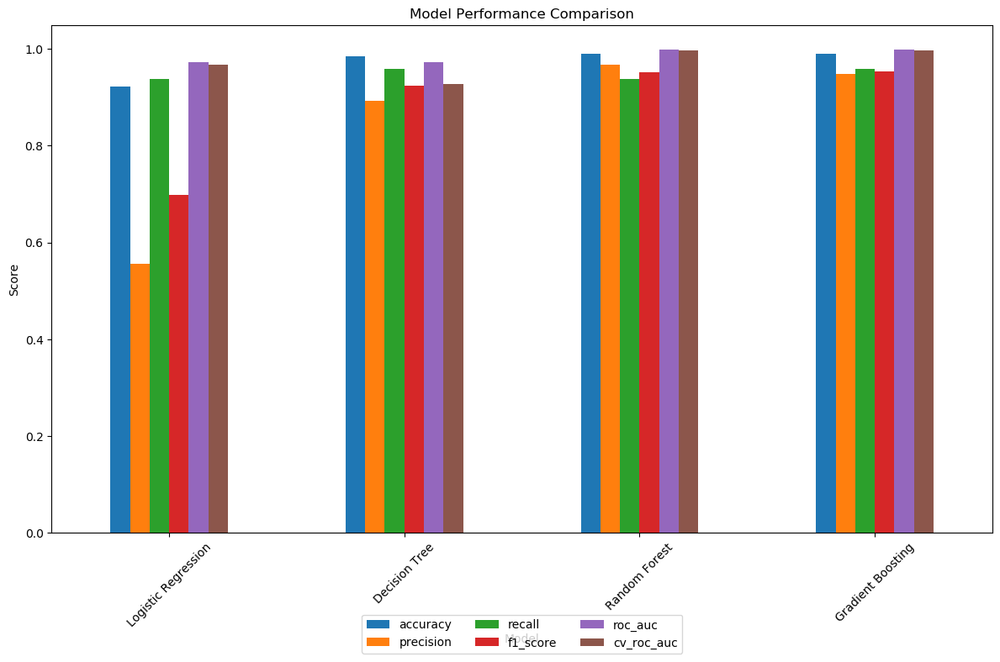

In [79]:

# Plot model performance comparison
plt.figure(figsize=(12, 8))
model_comparison.plot(kind='bar', figsize=(12, 8))
plt.title('Model Performance Comparison')
plt.ylabel('Score')
plt.xlabel('Model')
plt.xticks(rotation=45)
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=3)
plt.tight_layout()
plt.show()

## Model Performance Improvement

In [84]:
# Hyperparameter tuning for Random Forest
print("\nPerforming hyperparameter tuning for Random Forest...")

param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

rf_grid = GridSearchCV(
    RandomForestClassifier(class_weight='balanced', random_state=42),
    param_grid=param_grid,
    cv=5,
    scoring='roc_auc',
    n_jobs=-1
)

rf_grid.fit(X_train_transformed, y_train)

print("Best parameters:", rf_grid.best_params_)
print("Best cross-validation score:", rf_grid.best_score_)




Performing hyperparameter tuning for Random Forest...


/Users/memorodriguez/opt/anaconda3/lib/python3.7/site-packages/sklearn/ensemble/forest.py:489: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  y_store_unique_indices = np.zeros(y.shape, dtype=np.int)
/Users/memorodriguez/opt/anaconda3/lib/python3.7/site-packages/sklearn/ensemble/forest.py:489: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify 

Best parameters: {'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}
Best cross-validation score: 0.9967714211008121



Model: Best Random Forest
Cross-validation ROC-AUC: 0.9968 (±0.0013)
Test Accuracy: 0.9910
Test Precision: 0.9677
Test Recall: 0.9375
Test F1-score: 0.9524
Test ROC-AUC: 0.9989

Classification Report:
              precision    recall  f1-score   support

           0       0.99      1.00      1.00       904
           1       0.97      0.94      0.95        96

    accuracy                           0.99      1000
   macro avg       0.98      0.97      0.97      1000
weighted avg       0.99      0.99      0.99      1000



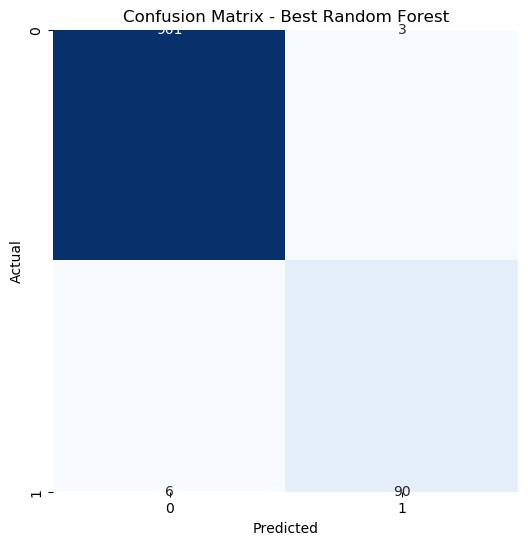

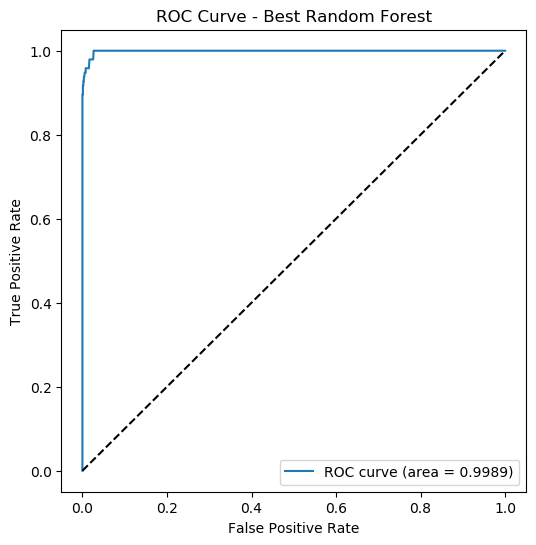

In [85]:
# Evaluate the best model
best_rf = rf_grid.best_estimator_
results['Best Random Forest'] = evaluate_model(best_rf, X_train_transformed, X_test_transformed,y_train, y_test, 'Best Random Forest')

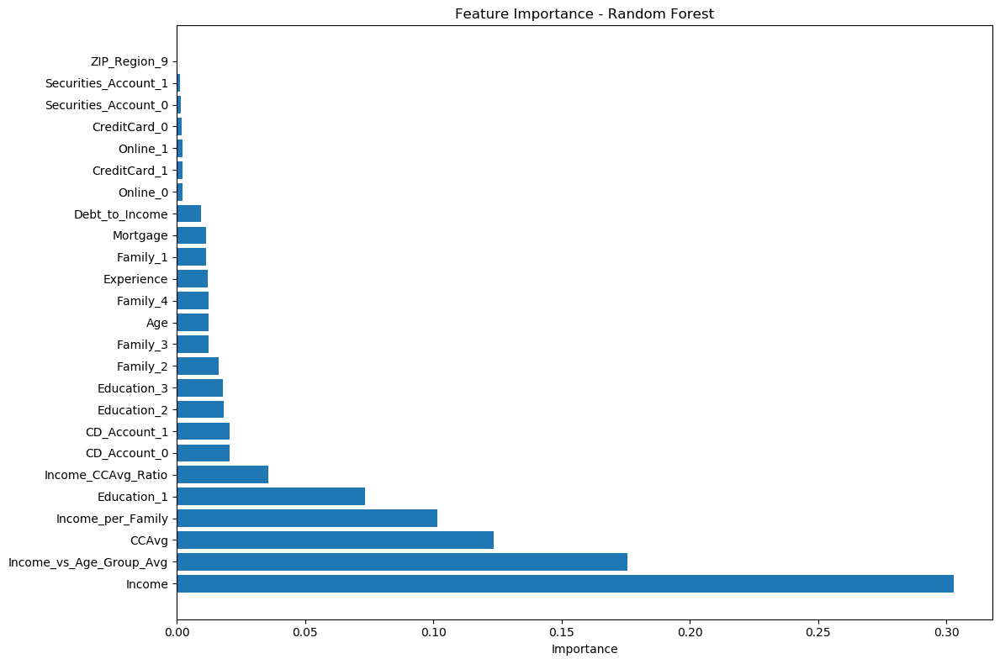


Top 10 important features:
Income: 0.3028
Income_vs_Age_Group_Avg: 0.1757
CCAvg: 0.1237
Income_per_Family: 0.1015
Education_1: 0.0735
Income_CCAvg_Ratio: 0.0358
CD_Account_0: 0.0206
CD_Account_1: 0.0206
Education_2: 0.0185
Education_3: 0.0179


In [87]:
# Feature importance for the best model
if hasattr(best_rf, 'feature_importances_'):
    # Get feature names after transformation
    ohe = preprocessor.named_transformers_['cat']
    # Use get_feature_names() for older scikit-learn versions
    try:
        cat_feature_names = ohe.get_feature_names_out(categorical_features)
    except AttributeError:
        # Fall back to get_feature_names() for older versions
        cat_feature_names = ohe.get_feature_names(categorical_features)
    
    feature_names = np.concatenate([numerical_features, cat_feature_names])
    
    # Get feature importances
    feature_importances = best_rf.feature_importances_
    
    # Sort features by importance
    sorted_idx = feature_importances.argsort()[::-1]
    
    # Plot feature importances
    plt.figure(figsize=(12, 8))
    plt.barh(range(len(sorted_idx)), feature_importances[sorted_idx])
    plt.yticks(range(len(sorted_idx)), feature_names[sorted_idx])
    plt.title('Feature Importance - Random Forest')
    plt.xlabel('Importance')
    plt.tight_layout()
    plt.show()
    
    # Print top 10 features
    print("\nTop 10 important features:")
    for i in range(min(10, len(sorted_idx))):
        print(f"{feature_names[sorted_idx[i]]}: {feature_importances[sorted_idx[i]]:.4f}")

## Model Performance Comparison and Final Model Selection

<Figure size 1200x800 with 0 Axes>

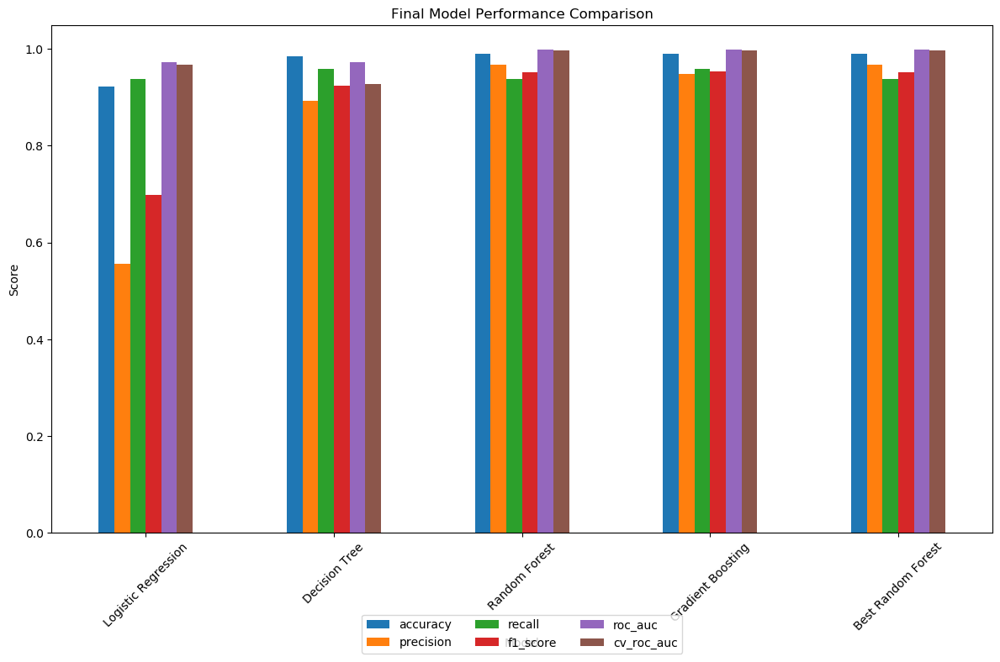


Best performing model: Gradient Boosting
ROC-AUC score: 0.9990


In [90]:
# Update model comparison with the best model
model_comparison_data = {}
for model_name in results:
    # Extract all metrics except the model object itself
    model_metrics = {k: v for k, v in results[model_name].items() if k != 'model'}
    model_comparison_data[model_name] = model_metrics

# Create DataFrame from the metrics
model_comparison = pd.DataFrame(model_comparison_data).T

# Plot the updated model performance comparison
plt.figure(figsize=(12, 8))
model_comparison.plot(kind='bar', figsize=(12, 8))
plt.title('Final Model Performance Comparison')
plt.ylabel('Score')
plt.xlabel('Model')
plt.xticks(rotation=45)
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=3)
plt.tight_layout()
plt.show()

# Select the best model based on ROC-AUC score
best_model_name = model_comparison['roc_auc'].idxmax()
best_model = results[best_model_name]['model']
print(f"\nBest performing model: {best_model_name}")
print(f"ROC-AUC score: {model_comparison.loc[best_model_name, 'roc_auc']:.4f}")


## Actionable Insights and Business Recommendations


* What recommedations would you suggest to the bank?

In [94]:

# Income-based insights
print("1. Income-based targeting:")
income_loan = df.groupby(pd.cut(df['Income'], bins=[0, 50, 100, 150, 200, 250]))['Personal_Loan'].mean() * 100
print(income_loan)
print("We recommend to focus marketing our efforts on customers with higher income brackets, especially those earning more than $100K.")

# Education-based insights
print("2. Education-based targeting:")
education_loan = df.groupby('Education')['Personal_Loan'].mean() * 100
print(education_loan)
print("We recommend to prioritize on customers with advanced or professional degrees, who show a higher approval to accept loans.")

# Credit card usage insights
print("3. Credit card usage insights:")
cc_loan = df.groupby(pd.cut(df['CCAvg'], bins=[0, 1, 2, 3, 4, 5, 10]))['Personal_Loan'].mean() * 100
print(cc_loan)
print("We recommend to target customers with higher credit card spending, as they show strate stronger loan approval rates.")

# Family size insights
print("4. Family size insights:")
family_loan = df.groupby('Family')['Personal_Loan'].mean() * 100
print(family_loan)
print("We recommend to target customers with larger families (3-4 members) show higher loan aproval, consider tailoring loan products to their needs.")

# Securities Account insights
sec_loan = df.groupby('Securities_Account')['Personal_Loan'].mean() * 100
print("5. Securities Account insights:")
print(sec_loan)
print("We recommend to target customers with securities accounts show higher loan acceptance rates, consider cross-selling opportunities.")

# CD Account insights
cd_loan = df.groupby('CD_Account')['Personal_Loan'].mean() * 100
print("6. CD Account insights:")
print(cd_loan)
print("We recommend to target customers with CD accounts are significantly more likely to accept loans, prioritize them for marketing campaigns.")

# Final recommendations
print("\nFinal Business Recommendations:")
print("1. Develop targeted marketing campaigns for high-income customers (>$100K) with advanced degrees.")
print("2. Create special loan products for families with 3-4 members who have higher acceptance rates.")
print("3. Leverage existing relationships with customers who have securities and CD accounts for cross-selling opportunities.")
print("4. Consider offering preferential loan terms to customers with high credit card spending, as they show higher acceptance rates.")
print("5. Focus on age-based segmentation, particularly for the middle-age brackets (36-45 and 46-55) where loan acceptance rates are typically higher.")
print("6. Target customers whose income is significantly above average for their age group, as they show a greater propensity to accept loans.")
print("7. Develop a customer scoring system based on the model to prioritize marketing efforts toward the most promising prospects.")
print("8. Set up an automated system to identify and flag high-probability customers for the marketing team to follow up with.")

1. Income-based targeting:
Income
(0, 50]        0.000000
(50, 100]      2.241195
(100, 150]    28.571429
(150, 200]    49.321267
(200, 250]          NaN
Name: Personal_Loan, dtype: float64
We recommend to focus marketing our efforts on customers with higher income brackets, especially those earning more than $100K.
2. Education-based targeting:
Education
1     4.437023
2    12.972202
3    13.657562
Name: Personal_Loan, dtype: float64
We recommend to prioritize on customers with advanced or professional degrees, who show a higher approval to accept loans.
3. Credit card usage insights:
CCAvg
(0, 1]      2.654867
(1, 2]      3.525881
(2, 3]      7.853982
(3, 4]     30.769231
(4, 5]     40.686275
(5, 10]    39.884393
Name: Personal_Loan, dtype: float64
We recommend to target customers with higher credit card spending, as they show strate stronger loan approval rates.
4. Family size insights:
Family
1     7.269022
2     8.179012
3    13.168317
4    10.965630
Name: Personal_Loan, dtype: fl

___